### Intro

This notebook is used to preprocess the raw tables scanned from the book were the original publication was published.
The goal is to extract the tables and convert them to a standardized format allowing us to get the subimages from each
cell simply by indexing into standardized table images using row and column pixel coordinates.

### Magics

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

### Imports

In [2]:
# Use pathlib
from pathlib import Path

# We will load images using PIL
from PIL import Image as PILImage

# We will use numpy for numerical operations, some other numerical libraries are also needed
import numpy as np
from scipy import ndimage
from skimage.transform import resize
from scipy.signal import find_peaks

# We need some image processing stuff from mathematical morphology
from skimage.morphology import dilation, disk, erosion

# We will use matplotlib for plotting
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches
from matplotlib.colors import to_rgba

# We will use tqdm for progress bars
from tqdm.notebook import tqdm

# We will use joblib for parallel processing
from joblib import Parallel, delayed

# Pandas for the tables of data
import pandas as pd

# Need regex
import re

# Pickle
import pickle as pkl

# Finally our own stuff
from phenology import *

### Some parameters

We will use morphology to spruce up the text a bit, set parameters here

In [3]:
SELEM_SIZE = 1.5
ELEM_SIZE = 111
ELEM_SIZE_HALF = ELEM_SIZE // 2

Surprisingly, it helps to upscale the images a bit for the model to read them...

In [4]:
INFERENCE_SCALE_FACTOR = 2

### Load the raw tables as scanned from the book

In [5]:
raw_tables_dir = Path('../data/raw/')

### Take a look at raw tables as scanned

In [6]:
#raw_tables = sorted(raw_tables_dir.glob('*.tif'))[:20] # Use this for testing
raw_tables = sorted(raw_tables_dir.glob('*.tif'))

In [7]:
raw_tables[:20]

[PosixPath('../data/raw/table_001.tif'),
 PosixPath('../data/raw/table_002.tif'),
 PosixPath('../data/raw/table_003.tif'),
 PosixPath('../data/raw/table_004.tif'),
 PosixPath('../data/raw/table_005.tif'),
 PosixPath('../data/raw/table_006.tif'),
 PosixPath('../data/raw/table_007.tif'),
 PosixPath('../data/raw/table_008.tif'),
 PosixPath('../data/raw/table_009.tif'),
 PosixPath('../data/raw/table_010.tif'),
 PosixPath('../data/raw/table_011.tif'),
 PosixPath('../data/raw/table_012.tif'),
 PosixPath('../data/raw/table_013.tif'),
 PosixPath('../data/raw/table_014.tif'),
 PosixPath('../data/raw/table_015.tif'),
 PosixPath('../data/raw/table_016.tif'),
 PosixPath('../data/raw/table_017.tif'),
 PosixPath('../data/raw/table_018.tif'),
 PosixPath('../data/raw/table_019.tif'),
 PosixPath('../data/raw/table_020.tif')]

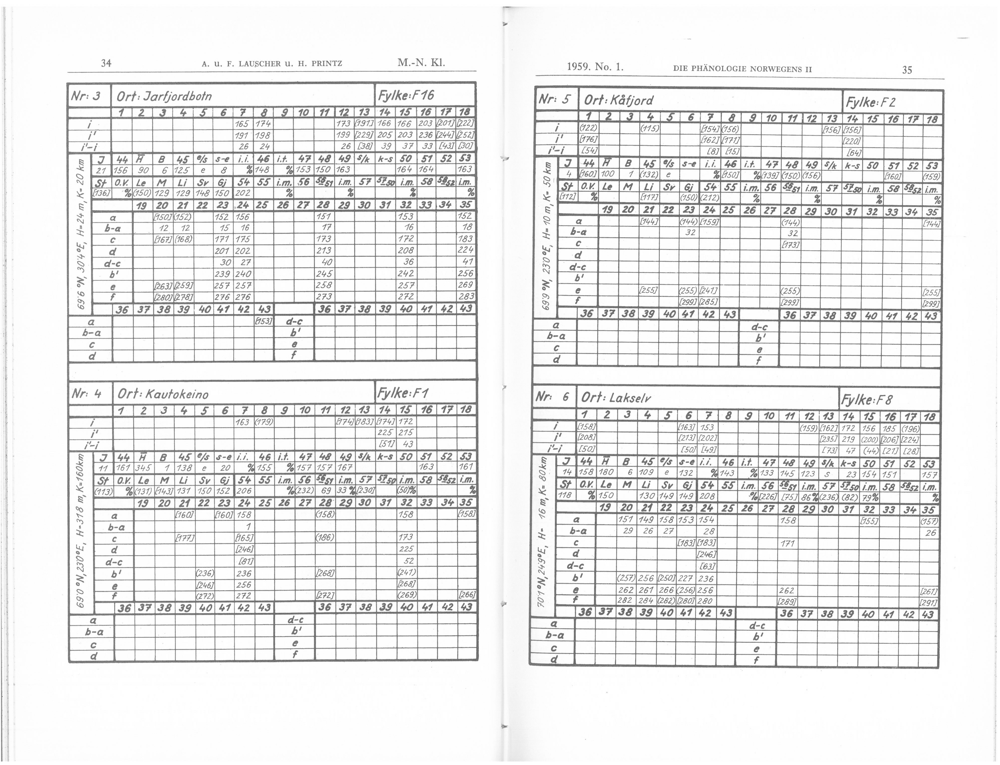

In [8]:
PILImage.open(raw_tables[1])

### Begin by splitting the pages by "brute forcing"

In this process, also strip off some of the white space and convert the images to numpy arrays.  Since the first spread contains only one table (the right page), we handle this separately.

In [9]:
strip_top_N = 300
strip_bottom_N = 2750
strip_left_N = 150
strip_right_N = 1950
strip_offset = 1930
raw_table_pages = []
raw_table_pages.append(np.array(PILImage.open(raw_tables[0]).convert('L'))[strip_top_N:strip_bottom_N, 2050:(2050+1800)])
for idx in range(1, len(raw_tables)):
    raw_table_page = np.array(PILImage.open(raw_tables[idx]).convert('L'))
    raw_table_page = raw_table_page.astype(np.float32)
    raw_table_pages.append(raw_table_page[strip_top_N:strip_bottom_N, strip_left_N:strip_right_N])
    raw_table_pages.append(raw_table_page[strip_top_N:strip_bottom_N, (strip_offset + strip_left_N):(strip_offset + strip_right_N)])

Then take a look at a split page

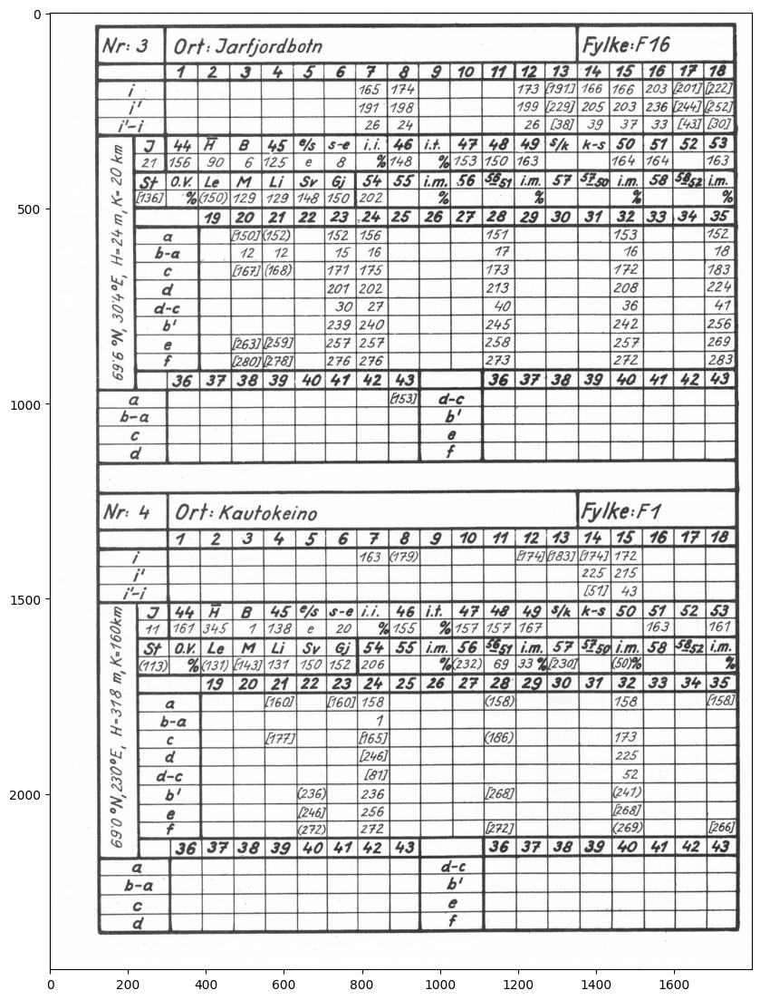

In [10]:
fig, axs = plt.subplots(1, 1, figsize=(10, 15))
axs.imshow(raw_table_pages[1], cmap='gray')
plt.show()

To make more sure this worked, take a look at some randomly selected pages...

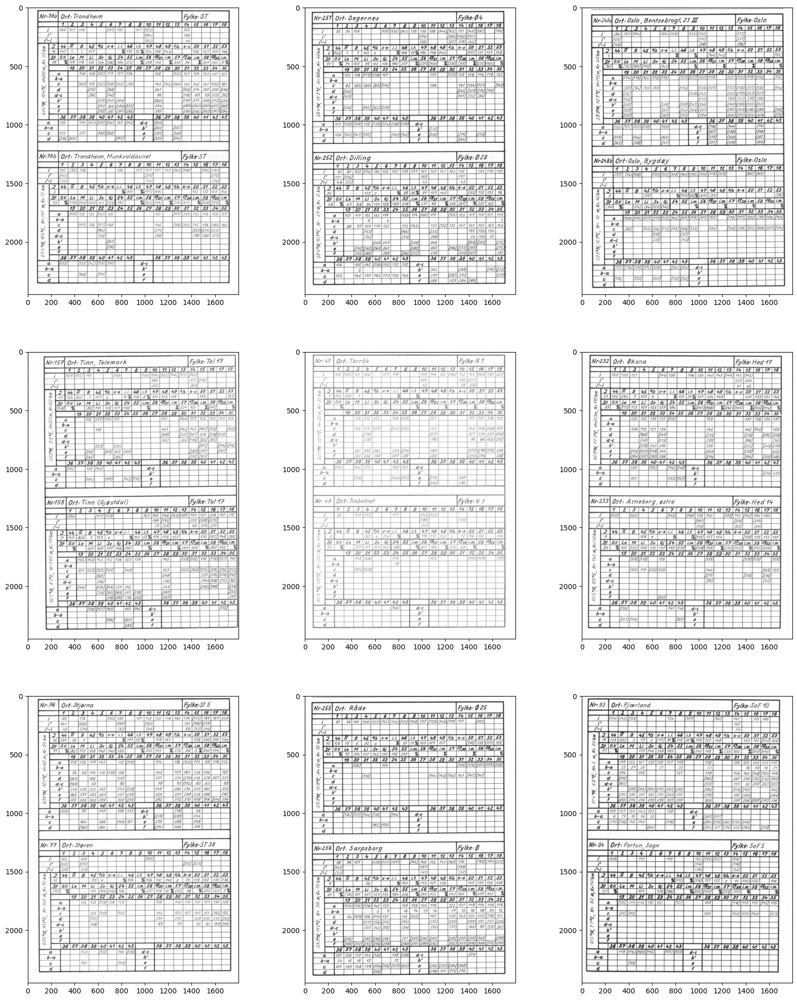

In [11]:
indexes = np.random.choice(range(len(raw_table_pages)), size=9, replace=False)
#indexes = np.arange(9)
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
for i in range(3):
    for j in range(3):
        axs[i, j].imshow(raw_table_pages[indexes[i*3+j]], cmap='gray')
plt.show()


### Now rotate each table page to zero rotation

There are many ways to determine the rotation of the pages.  We could use the Hough transform to detect the
orientation of the lines, we could use mathematical morphology to detect table corners etc., but a very simple,
although ad hoc, method is illustrated below.  Simply iterate a process where you sum vertically, rotate by a small
amount and repeat while looking for the maximal values of the peaks in the vertical projections.  The rotation
that produces the maximal projection peaks corresponds to the rotation of the table...

In [12]:
N = 1

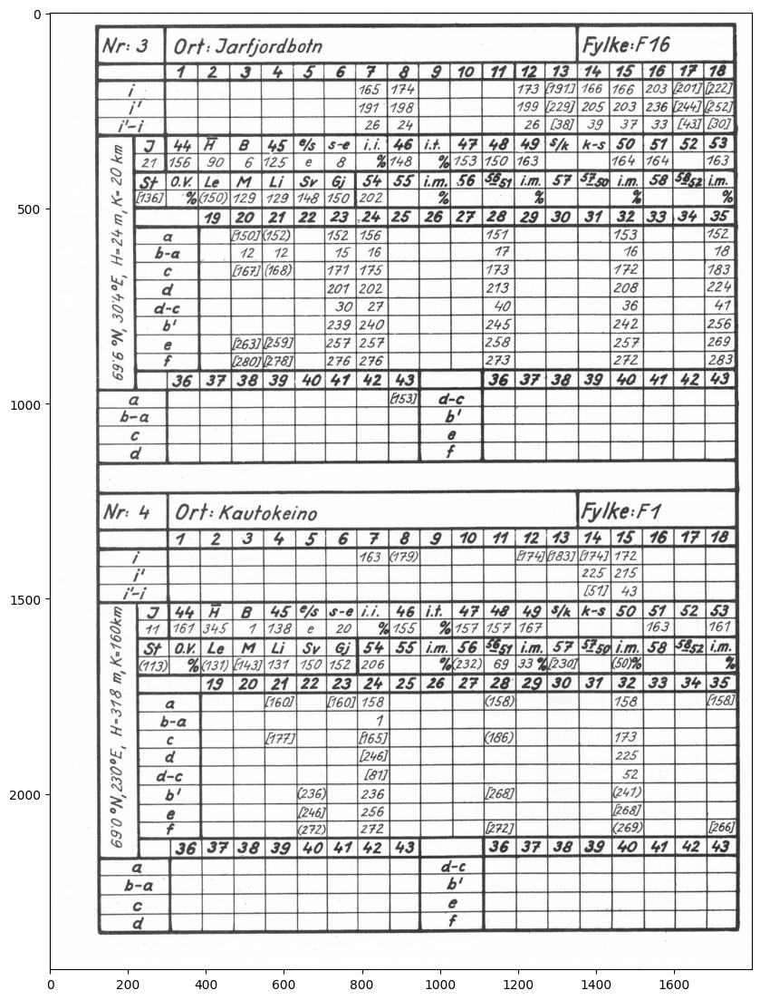

In [13]:
fig, axs = plt.subplots(1, 1, figsize=(10, 15))
axs.imshow(raw_table_pages[N], cmap='gray')
plt.show()

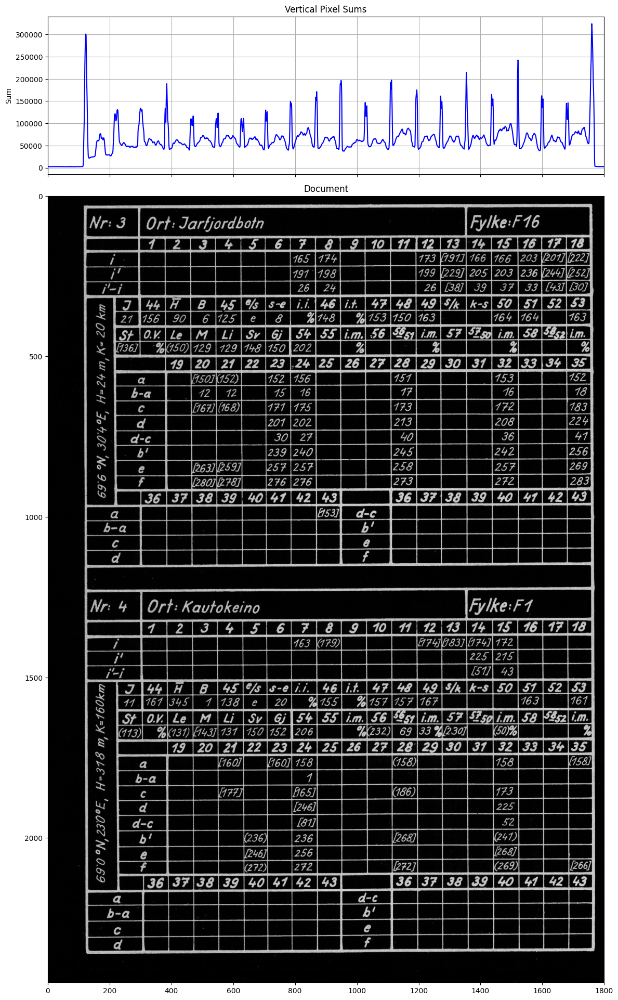

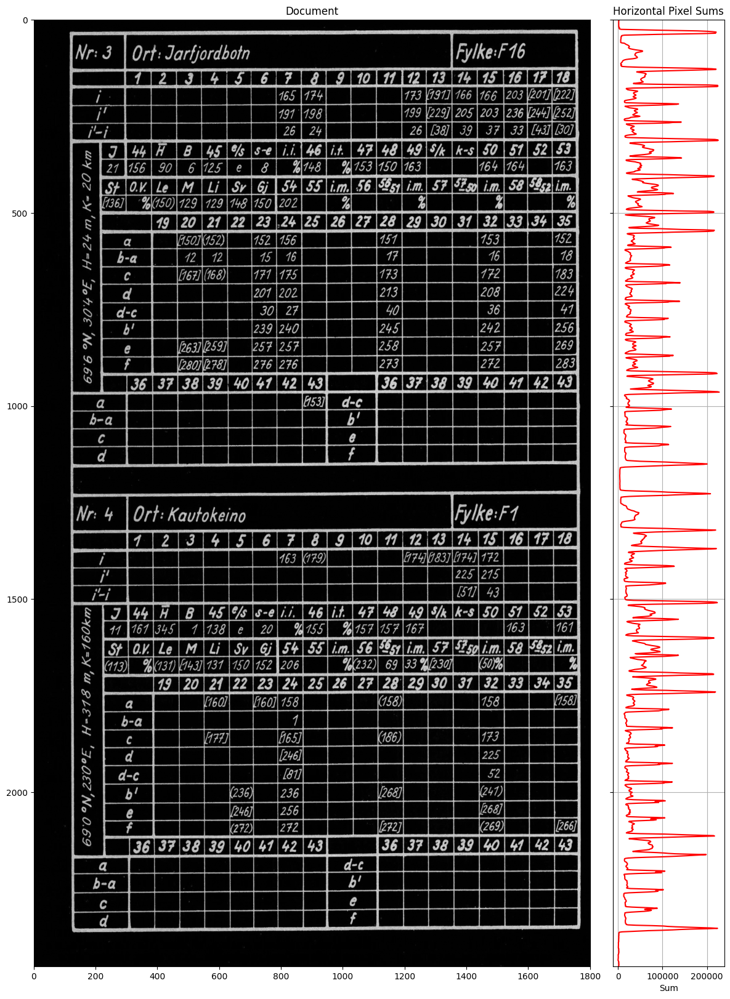

In [14]:
height, width = raw_table_pages[N].shape
aspect_ratio = width / height

figsize_v = (12, 12/aspect_ratio + 3)
figsize_h = (12, 12/aspect_ratio)

fig_vert, fig_horz, h_proj, v_proj = plot_projections(
    raw_table_pages[N], 
    figsize_v=figsize_v,
    figsize_h=figsize_h
)

plt.show()

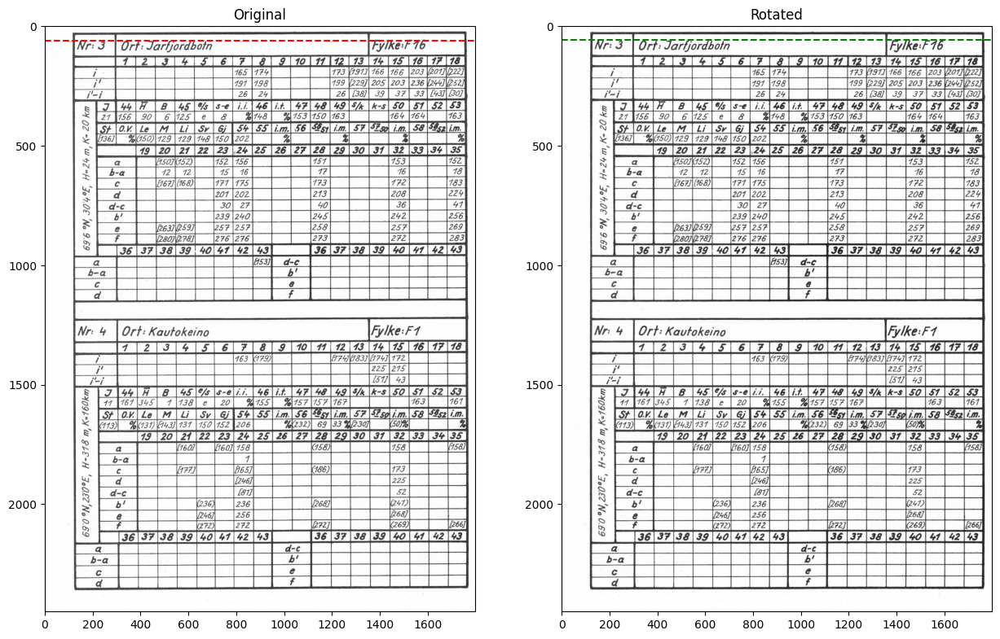

In [15]:
max_sum_of_rows_rotation = image_rotation_analysis(raw_table_pages[N])
fig, ax = plt.subplots(1, 2, figsize=(15, 20))
ax[0].imshow(raw_table_pages[N], cmap='gray')
rotated_image = ndimage.rotate(raw_table_pages[N], max_sum_of_rows_rotation, reshape=False, mode="nearest", order=1)
ax[1].imshow(rotated_image, cmap='gray')
ax[0].set_title('Original')
ax[1].set_title('Rotated')
ax[0].axhline(y=60, color='r', linestyle='--')
ax[1].axhline(y=56, color='g', linestyle='--')
plt.show()

In [16]:
# Define process_page function
def process_page(idx, raw_table_page):
    max_sum_of_rows_rotation = image_rotation_analysis(raw_table_page)
    return idx, ndimage.rotate(raw_table_page, max_sum_of_rows_rotation, reshape=False, mode="nearest", order=1)

# Chunk pages for parallel processing
chunk_size = max(1, len(raw_table_pages) // 10)
chunks = np.array_split(range(len(raw_table_pages)), chunk_size)

results = []
for chunk in tqdm(chunks, desc="Processing pages in batches..."):
    with Parallel(n_jobs=-1, backend='loky') as parallel:
        chunk_results = parallel(
            delayed(process_page)(idx, raw_table_pages[idx]) 
            for idx in chunk
        )
    results.extend(chunk_results)

for idx, rotated_page in results:
    raw_table_pages[idx] = rotated_page

Processing pages in batches...:   0%|          | 0/13 [00:00<?, ?it/s]

Take a look at a selection of images to check if this went well, the red horizontal lines in the plots are there just to make it possible to judge
that the images have indeed been "derotated"

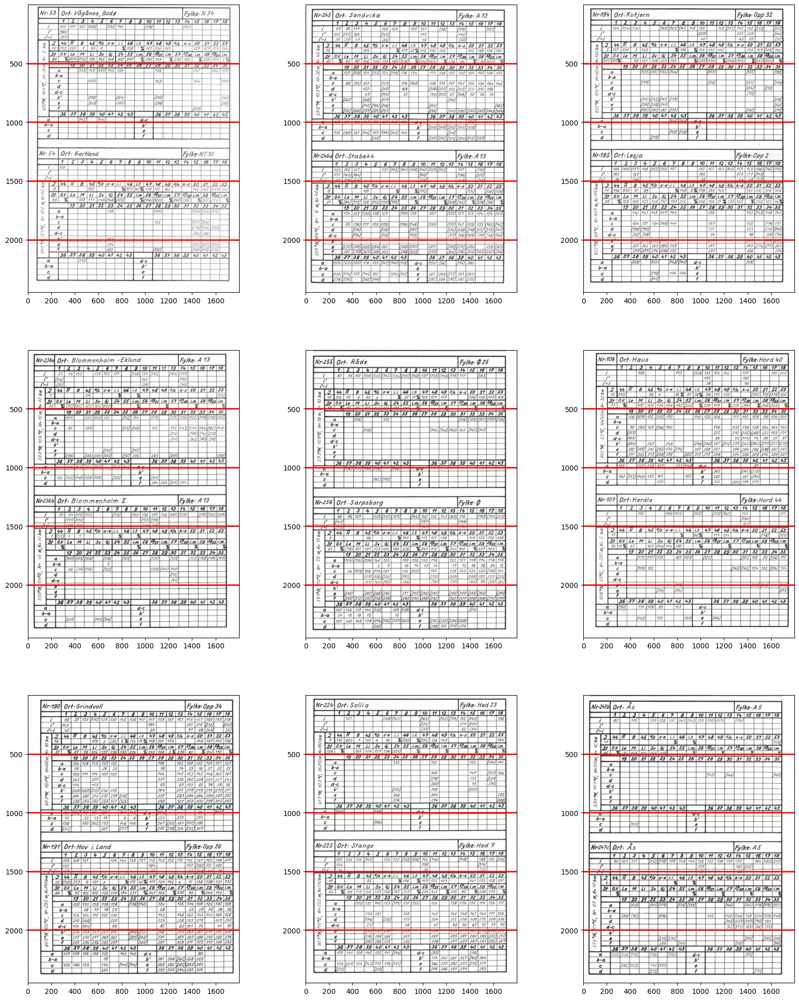

In [17]:
line_N = 60
indexes = np.random.choice(range(len(raw_table_pages)), size=9, replace=False)
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
for i in range(3):
    for j in range(3):
        axs[i, j].imshow(raw_table_pages[indexes[i*3+j]], cmap='gray')
        axs[i, j].set_yticks([500, 1000, 1500, 2000])
        axs[i, j].grid(True, color='r', linestyle='-', linewidth=2, alpha=1.0, axis='y')
plt.show()

### Then we need to crop...start by the upper left corner

We use a nifty trick from mathematical morphology to do this.  Essentially, we invert the images and the perform a morphological erosion using a structuring element adapted to finding corners...

In [18]:
upper_left_corner_selem = np.zeros((ELEM_SIZE, ELEM_SIZE), dtype=np.uint8)
upper_left_corner_selem[ELEM_SIZE_HALF, ELEM_SIZE_HALF:ELEM_SIZE] = 1
upper_left_corner_selem[ELEM_SIZE_HALF:ELEM_SIZE, ELEM_SIZE_HALF] = 1

In [19]:
lower_right_corner_selem = np.zeros((ELEM_SIZE, ELEM_SIZE), dtype=np.uint8)
lower_right_corner_selem[0:ELEM_SIZE_HALF, ELEM_SIZE_HALF] = 1
lower_right_corner_selem[ELEM_SIZE_HALF, 0:ELEM_SIZE_HALF] = 1

These are the structuring elements we will use...

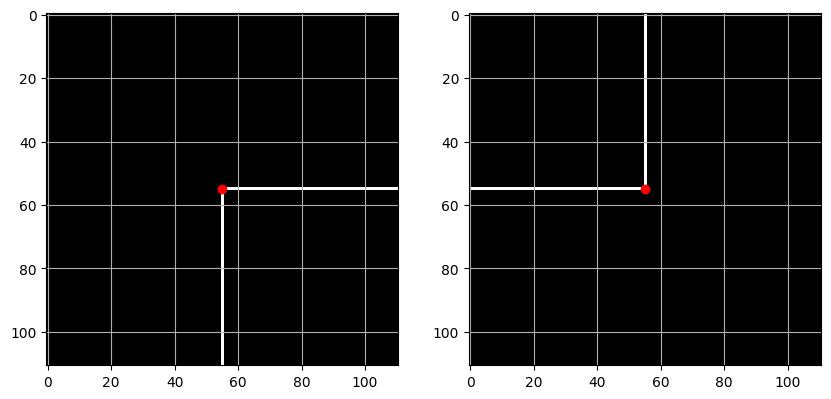

In [20]:
fig, ax = plt.subplots(1, 2, figsize=(10, 10))
ax[0].imshow(255 * upper_left_corner_selem, cmap='gray', vmin=0, vmax=255)
ax[0].grid(True)
ax[0].plot(ELEM_SIZE_HALF, ELEM_SIZE_HALF, 'ro')
ax[1].imshow(255 * lower_right_corner_selem, cmap='gray', vmin=0, vmax=255)
ax[1].grid(True)
ax[1].plot(ELEM_SIZE_HALF, ELEM_SIZE_HALF, 'ro')
plt.show()

For testing, get the corner candidates and get the upper left and lower right corner

In [21]:
upper_left_corner_candidate = erosion(np.max(raw_table_pages[0]) - raw_table_pages[0], upper_left_corner_selem)
upper_left_corner_candidate = upper_left_corner_candidate > 50

In [22]:
lower_right_corner_candidate = erosion(np.max(raw_table_pages[0]) - raw_table_pages[0], lower_right_corner_selem)
lower_right_corner_candidate = lower_right_corner_candidate > 50

In [23]:
upper_left_corner_row, upper_left_corner_col = find_corner(upper_left_corner_candidate, 'upper_left')
upper_left_corner_row, upper_left_corner_col

(np.int64(33), np.int64(85))

In [24]:
lower_right_corner_row, lower_right_corner_col = find_corner(lower_right_corner_candidate, 'lower_right')
lower_right_corner_row, lower_right_corner_col

(np.int64(2357), np.int64(1720))

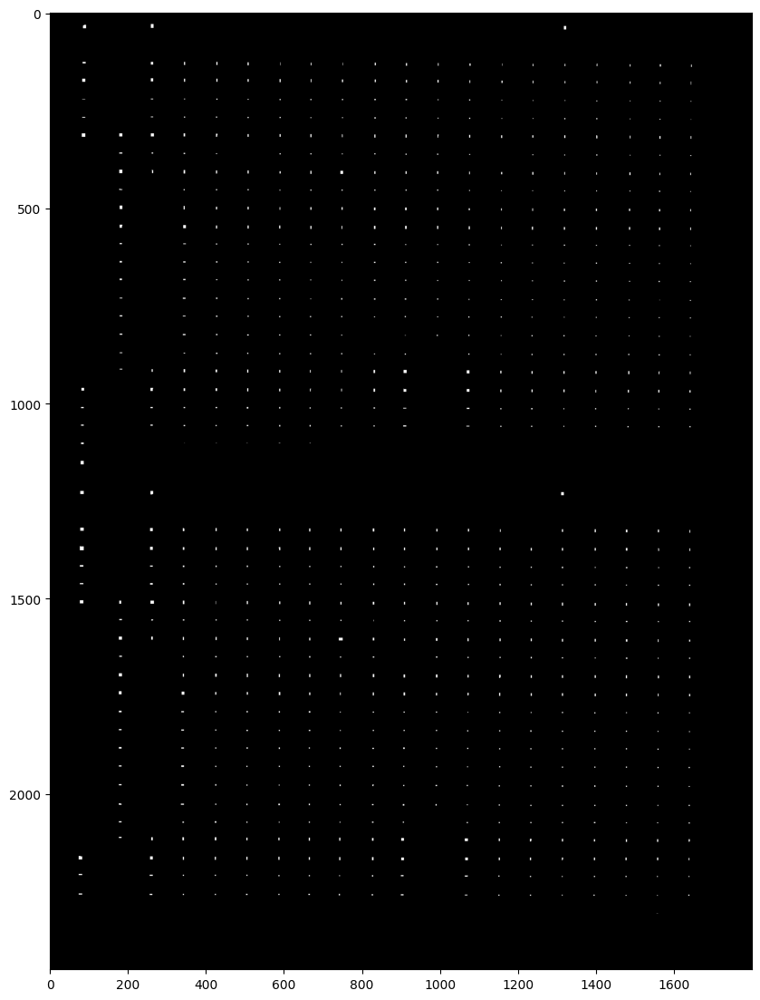

In [25]:
fig, ax = plt.subplots(1, 1, figsize=(10, 15))
ax.imshow(upper_left_corner_candidate, cmap='gray')
plt.show()

Show the final candidates on top of the test image

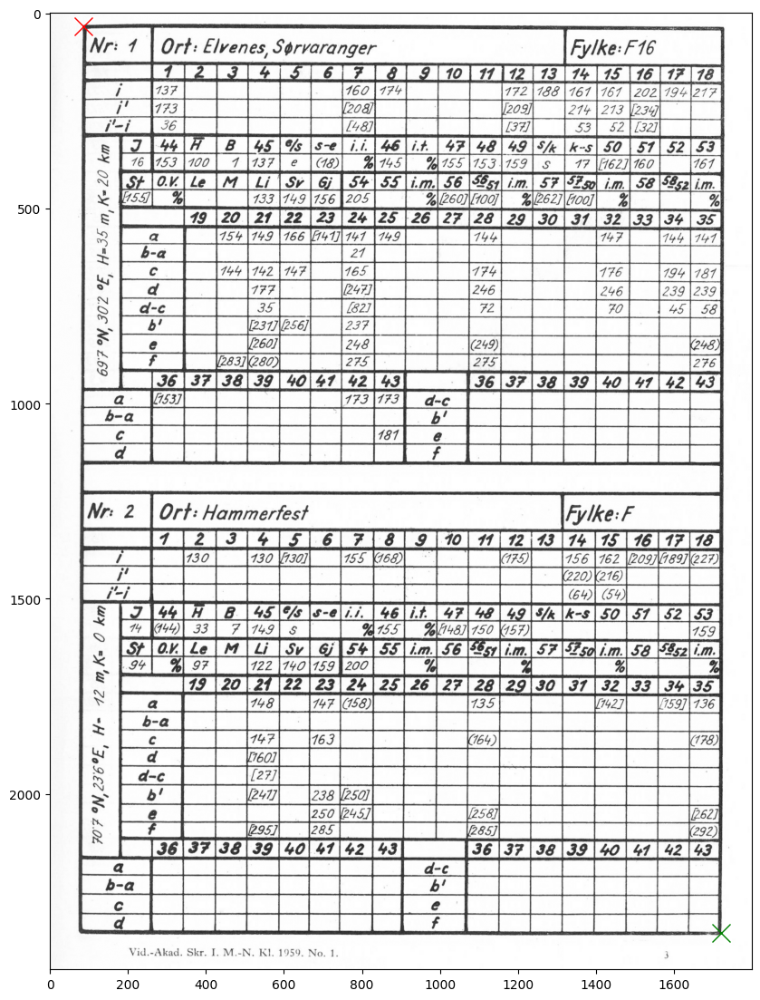

In [26]:
fig, ax = plt.subplots(1, 1, figsize=(10, 15))
ax.imshow(raw_table_pages[0], cmap='gray')
ax.plot(upper_left_corner_col, upper_left_corner_row, 'rx', markersize=15)
ax.plot(lower_right_corner_col, lower_right_corner_row, 'gx', markersize=15)
plt.show()

Then do this for all the pages

In [27]:
# First, define the process_page function
def process_page(idx, raw_table_page):
    # Candidates for upper left and lower right corners
    ul_candidate = erosion(np.max(raw_table_page) - raw_table_page, upper_left_corner_selem) > 50
    lr_candidate = erosion(np.max(raw_table_page) - raw_table_page, lower_right_corner_selem) > 50

    # Find corner positions
    ul_row, ul_col = find_corner(ul_candidate, 'upper_left')
    lr_row, lr_col = find_corner(lr_candidate, 'lower_right')

    # Crop and return
    cropped_page = raw_table_page[ul_row:lr_row, ul_col:lr_col]
    return idx, cropped_page

# Prepare parallel chunks
chunk_size = max(1, len(raw_table_pages) // 10)
chunks = np.array_split(range(len(raw_table_pages)), chunk_size)

results = []
for chunk in tqdm(chunks, desc="Processing pages in batches..."):
    with Parallel(n_jobs=-1, backend='loky') as parallel:
        chunk_results = parallel(delayed(process_page)(idx, raw_table_pages[idx]) for idx in chunk)
    results.extend(chunk_results)

# Assemble cropped pages
raw_table_pages_cropped = [None] * len(raw_table_pages)
for idx, cropped_page in results:
    raw_table_pages_cropped[idx] = cropped_page

Processing pages in batches...:   0%|          | 0/13 [00:00<?, ?it/s]

Take a look at a random selection of pages to see how this went

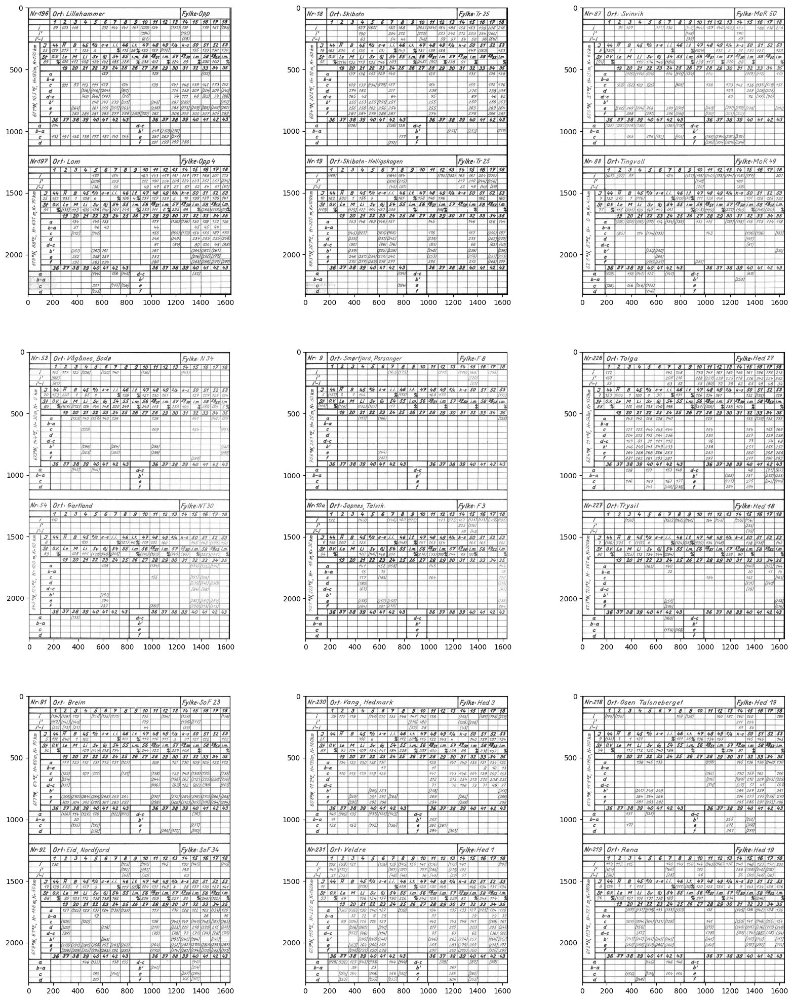

In [28]:
indexes = np.random.choice(range(len(raw_table_pages)), size=9, replace=False)
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
for i in range(3):
    for j in range(3):
        axs[i, j].imshow(raw_table_pages_cropped[indexes[i*3+j]], cmap='gray')
plt.show()

### Then we rescale the images to the same size

In [29]:
mean_height = np.mean([raw_table_page.shape[0] for raw_table_page in raw_table_pages_cropped])
mean_width = np.mean([raw_table_page.shape[1] for raw_table_page in raw_table_pages_cropped])
raw_table_pages_cropped_resized = []
for idx, raw_table_page in enumerate(raw_table_pages_cropped):
    raw_table_pages_cropped_resized.append(resize(raw_table_page, (mean_height, mean_width), anti_aliasing=True))

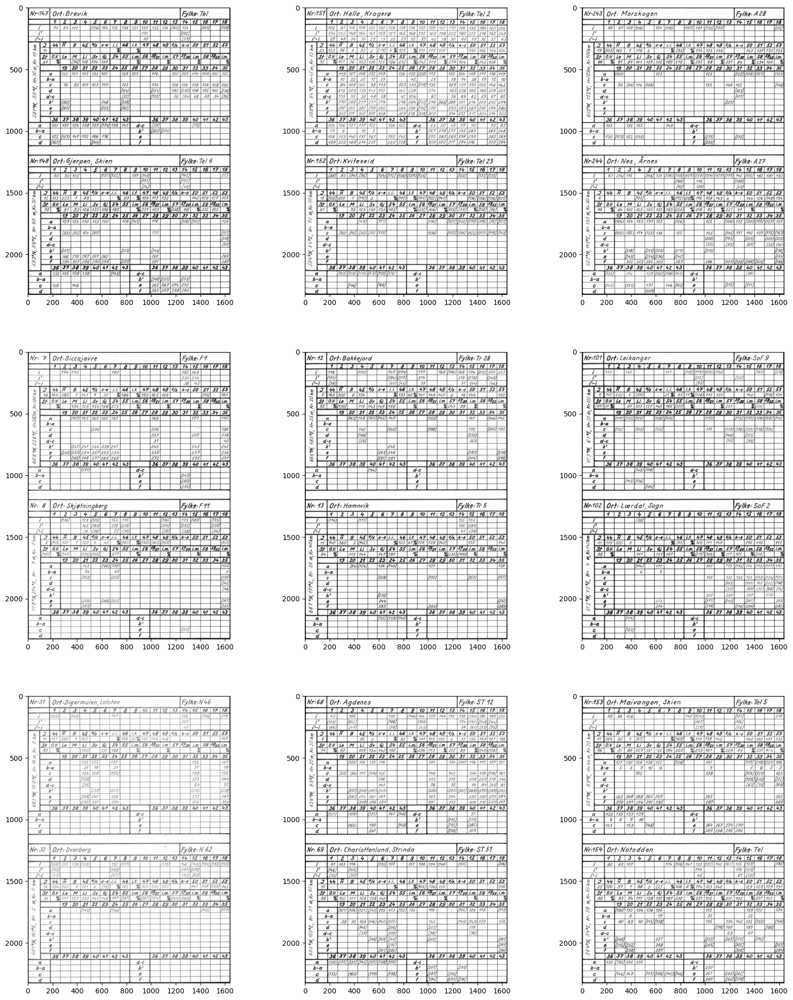

In [30]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
fig, axs = plt.subplots(3, 3, figsize=(20, 25))
for i in range(3):
    for j in range(3):
        axs[i, j].imshow(raw_table_pages_cropped_resized[indexes[i*3+j]], cmap='gray')
plt.show()

### Finally get the unique tables

In [31]:
tables = []
for page in raw_table_pages_cropped_resized:
    upper_table = page[0:1120, :]
    lower_table = page[1200:, :]
    ### Normalize the values in the tables
    upper_table = upper_table - upper_table.min()
    upper_table = upper_table / upper_table.max()
    lower_table = lower_table - lower_table.min()
    lower_table = lower_table / lower_table.max()
    tables.append(upper_table)
    tables.append(lower_table)

Just check that this worked as expected

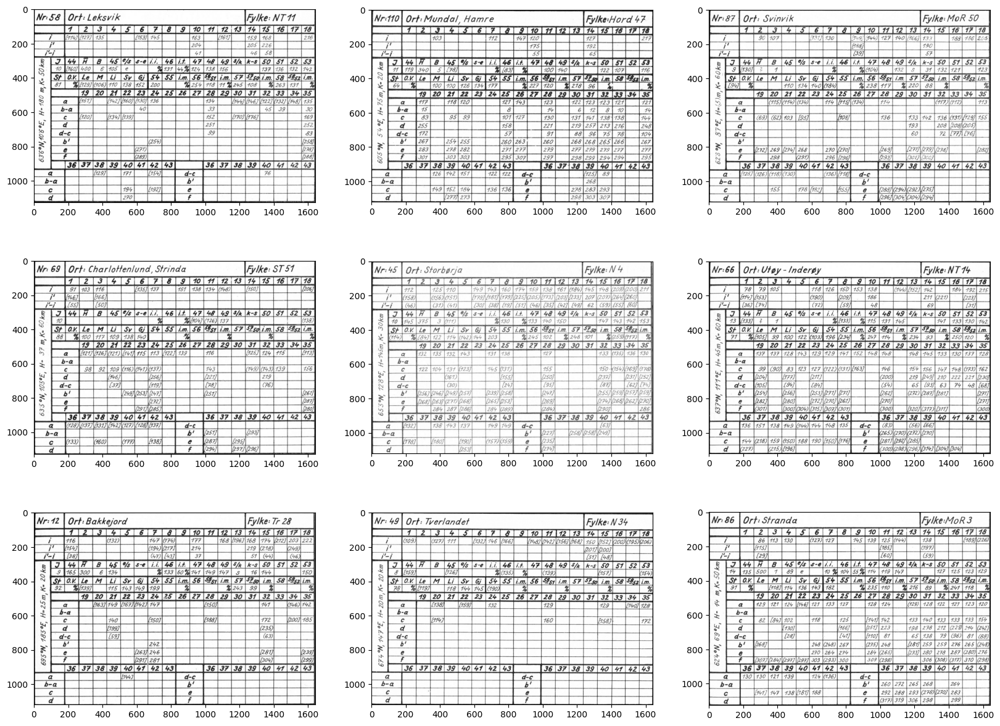

In [32]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
#indexes = np.arange(9)
fig, axs = plt.subplots(3, 3, figsize=(20, 15))
for i in range(3):
    for j in range(3):
        axs[i, j].imshow(tables[indexes[i*3+j]], cmap='gray', vmin=0.0, vmax=1.0)
plt.show()

How many tables do we finally have

In [33]:
len(tables)

278

Save the tables to a pickle file

In [34]:
with open('../data/processed/tables.pkl', 'wb') as f:
    pkl.dump(tables, f)

### Let's try and get a specific cell from all the images...

Start by getting a complete list of the species and their phases

In [35]:
species_phases_dicts = generate_species_phase_dicts(species_list)

Take a look at some of them

In [36]:
species_phases_dicts['coltsfoot_flowering']

{'norwegian_name': 'Hestehov',
 'english_name': 'Coltsfoot',
 'latin_name': 'Tussilago farfara',
 'phase': 'flowering',
 'row_start_idx': 2,
 'row_end_idx': 3,
 'col_start_idx': 2,
 'col_end_idx': 3}

In [37]:
species_phases_dicts['coltsfoot_fruit']

{'norwegian_name': 'Hestehov',
 'english_name': 'Coltsfoot',
 'latin_name': 'Tussilago farfara',
 'phase': 'fruit',
 'row_start_idx': 3,
 'row_end_idx': 4,
 'col_start_idx': 2,
 'col_end_idx': 3}

In [38]:
species_phases_dicts['coltsfoot_timespan']

{'norwegian_name': 'Hestehov',
 'english_name': 'Coltsfoot',
 'latin_name': 'Tussilago farfara',
 'phase': 'timespan',
 'row_start_idx': 4,
 'row_end_idx': 5,
 'col_start_idx': 2,
 'col_end_idx': 3}

In [39]:
species_phases_dicts['pine_greenup']

{'norwegian_name': 'Furu',
 'english_name': 'Pine',
 'latin_name': 'Pinus sylvestris',
 'phase': 'greenup',
 'row_start_idx': 19,
 'row_end_idx': 20,
 'col_start_idx': 9,
 'col_end_idx': 10}

In [40]:
species_phases_dicts['first_observation_of_wagtail']

{'norwegian_name': 'Første observasjon linerle',
 'english_name': 'First observation of wagtail',
 'latin_name': '',
 'phase': None,
 'row_start_idx': 8,
 'row_end_idx': 9,
 'col_start_idx': 5,
 'col_end_idx': 6}

In [41]:
species_phases_dicts['pine_start_senescence']

{'norwegian_name': 'Furu',
 'english_name': 'Pine',
 'latin_name': 'Pinus sylvestris',
 'phase': 'start_senescence',
 'row_start_idx': 20,
 'row_end_idx': 21,
 'col_start_idx': 19,
 'col_end_idx': 20}

Take a look at all the keys, they will be the names of the columns in the final data frame

In [42]:
for idx, k in enumerate(species_phases_dicts.keys()):
    print(f'{idx} ---> {k}')

0 ---> number
1 ---> location
2 ---> county
3 ---> position
4 ---> hasl
5 ---> ds
6 ---> coltsfoot_flowering
7 ---> coltsfoot_fruit
8 ---> coltsfoot_timespan
9 ---> liverleaf_flowering
10 ---> liverleaf_fruit
11 ---> liverleaf_timespan
12 ---> wood_anemone_flowering
13 ---> wood_anemone_fruit
14 ---> wood_anemone_timespan
15 ---> purple_saxifrage_flowering
16 ---> purple_saxifrage_fruit
17 ---> purple_saxifrage_timespan
18 ---> meadow_saxifrage_flowering
19 ---> meadow_saxifrage_fruit
20 ---> meadow_saxifrage_timespan
21 ---> cowslip_flowering
22 ---> cowslip_fruit
23 ---> cowslip_timespan
24 ---> marsh_marigold_flowering
25 ---> marsh_marigold_fruit
26 ---> marsh_marigold_timespan
27 ---> globeflower_flowering
28 ---> globeflower_fruit
29 ---> globeflower_timespan
30 ---> lily_of_the_valley_flowering
31 ---> lily_of_the_valley_fruit
32 ---> lily_of_the_valley_timespan
33 ---> wild_strawberry_flowering
34 ---> wild_strawberry_fruit
35 ---> wild_strawberry_timespan
36 ---> wood_sorrel_f

In order to make sure things have worked as we like you can display the location of a cell in an image

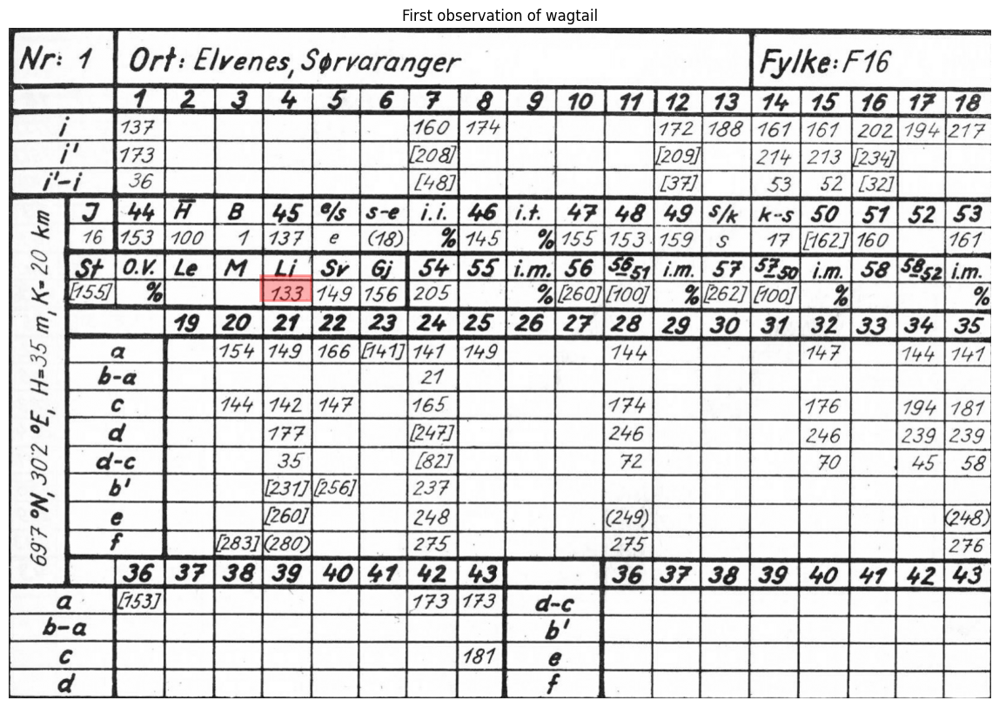

In [43]:
visualize_observation_phases(tables[0],
                             'First observation of wagtail',
                             None,
                             species_phases_dicts,
                             table_rows = table_rows,
                             table_cols = table_cols)

You can do this for a random selection of tables to make sure you get the right cell...

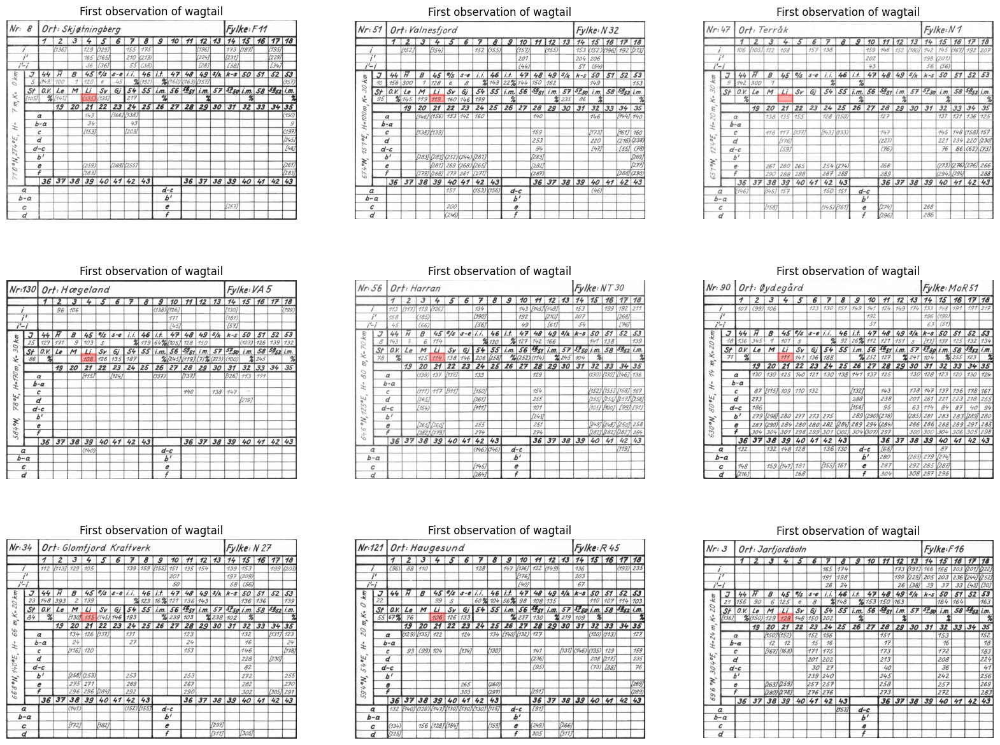

In [44]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
#indexes = np.arange(9)
fig, axs = plt.subplots(3, 3, figsize=(20, 15))
for i in range(3):
    for j in range(3):
        visualize_observation_phases(tables[indexes[i*3+j]],
                                     'First observation of wagtail',
                                     None,
                                     species_phases_dicts,
                                     table_rows = table_rows,
                                     table_cols = table_cols,
                                     ax = axs[i, j])

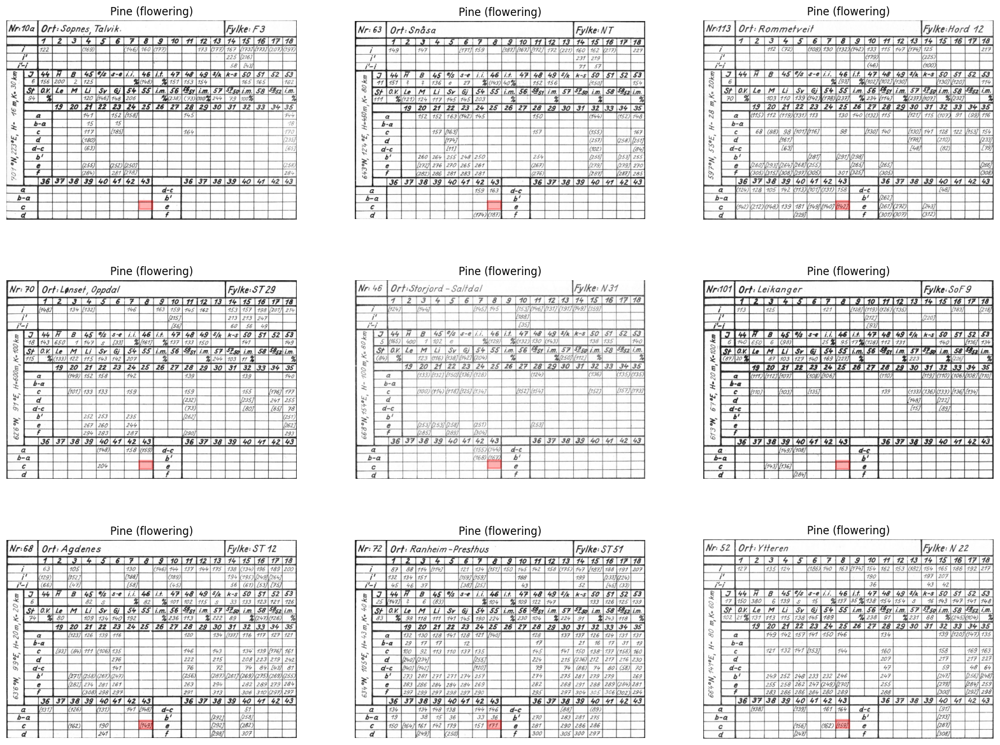

In [45]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
phase = 'flowering'
fig, axs = plt.subplots(3, 3, figsize=(20, 15))
for i in range(3):
    for j in range(3):
        visualize_observation_phases(tables[indexes[i*3+j]],
                                     'Pine',
                                     phase,
                                     species_phases_dicts,
                                     table_rows = table_rows,
                                     table_cols = table_cols,
                                     ax = axs[i, j])

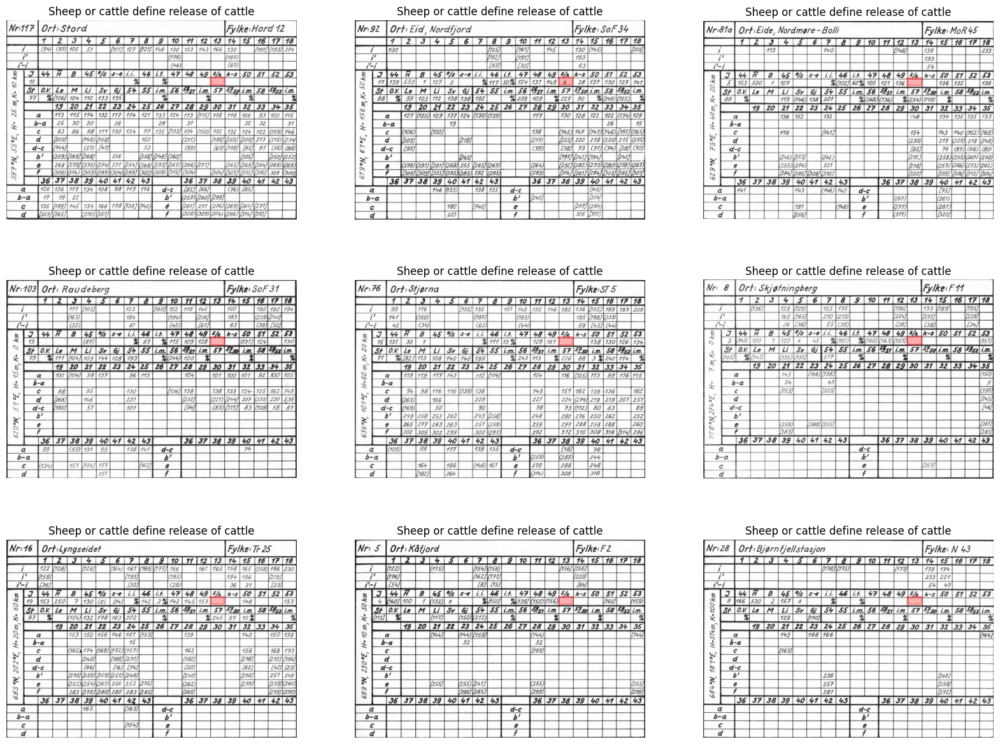

In [46]:
indexes = np.random.choice(range(len(raw_table_pages_cropped)), size=9, replace=False)
#indexes = np.arange(9)
phase = None
fig, axs = plt.subplots(3, 3, figsize=(20, 15))
for i in range(3):
    for j in range(3):
        visualize_observation_phases(tables[indexes[i*3+j]],
                                     'Sheep or cattle define release of cattle',
                                     phase,
                                     species_phases_dicts,
                                     table_rows = table_rows,
                                     table_cols = table_cols,
                                     ax = axs[i, j])

### Get information more systematically...

Another check is just looking at a random selection of data from the tables

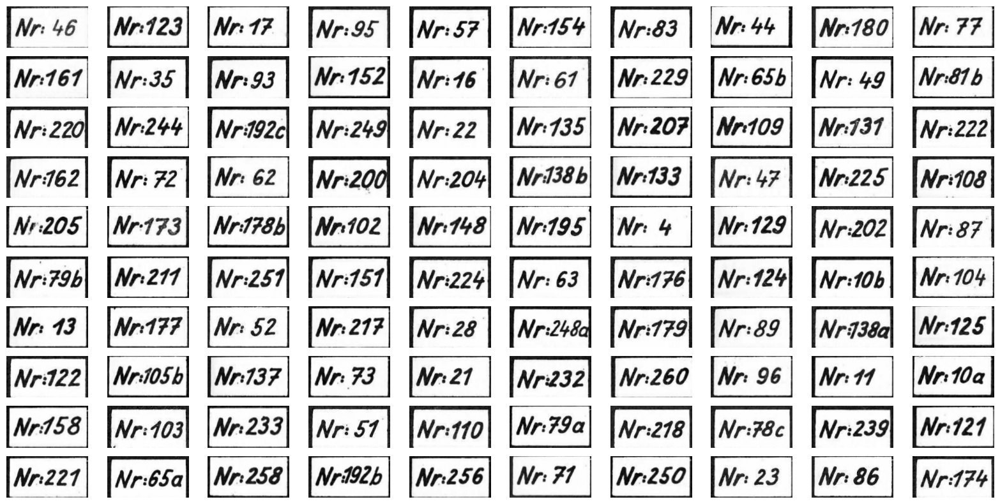

In [47]:
nr_images = show_selection(tables,
                           species_phases_dicts['number'],
                           offset = 7,
                           figsize=(20, 10),
                           rotate = False,
                           selem_size = SELEM_SIZE,
                           selection_size = 100,
                           subplot_size = (10, 10),
                           table_rows = table_rows,
                           table_cols = table_cols,
                           use_dilation = True)

Location images

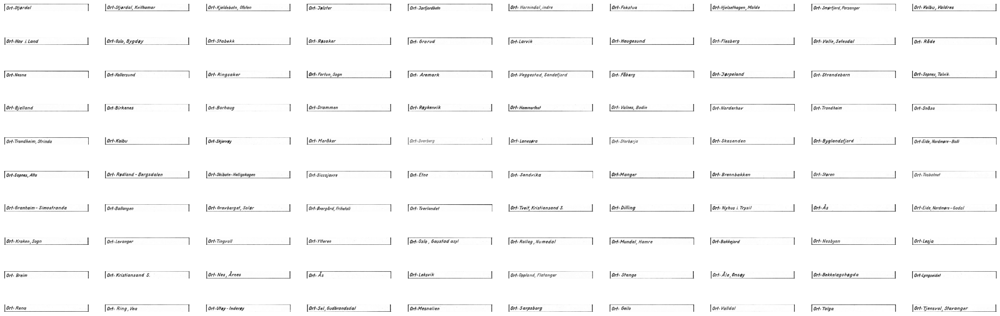

In [48]:
position_images = show_selection(tables,
                                 species_phases_dicts['location'],
                                 offset = 7,
                                 figsize=(30, 10),
                                 rotate = False,
                                 selem_size = SELEM_SIZE,
                                 selection_size = 100,
                                 subplot_size = (10, 10),
                                 table_rows = table_rows,
                                 table_cols = table_cols,
                                 use_dilation = True)

Position images

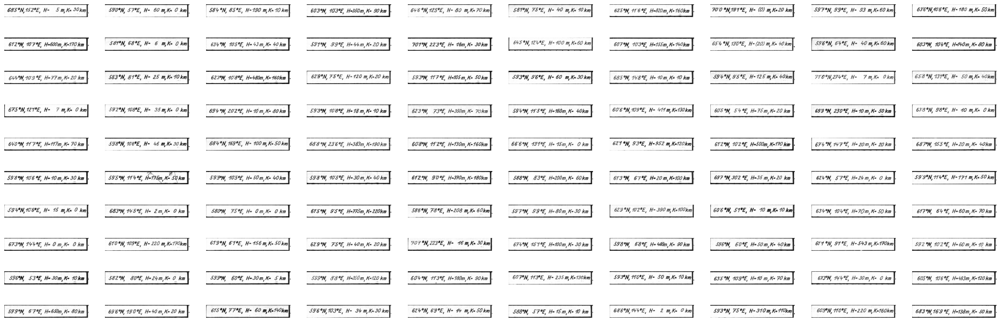

In [49]:
position_images = show_selection(tables,
                                 species_phases_dicts['position'],
                                 offset = 7,
                                 figsize=(30, 10),
                                 rotate = True,
                                 selem_size = SELEM_SIZE,
                                 selection_size = 100,
                                 subplot_size = (10, 10),
                                 table_rows = table_rows,
                                 table_cols = table_cols,
                                 use_dilation = True)

Coltsfoot flowering images

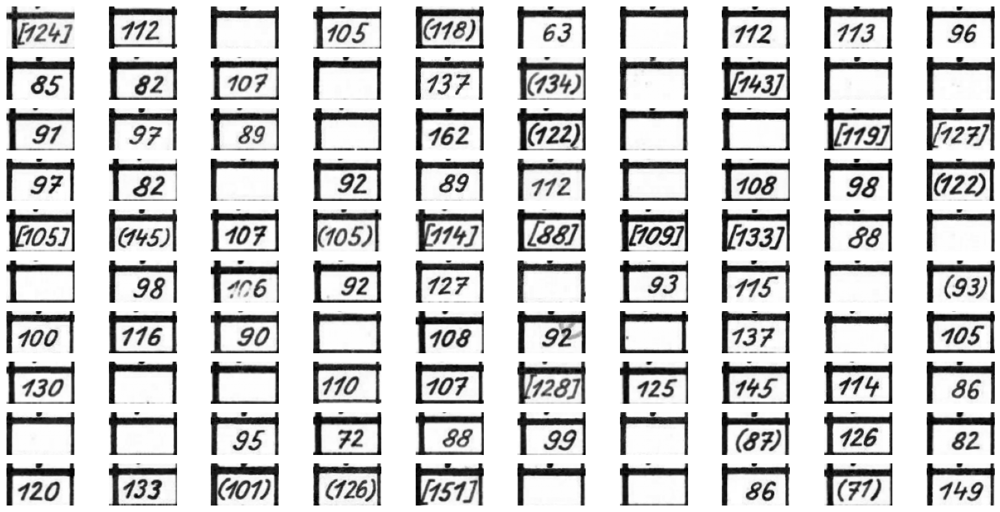

In [50]:
coltsfoot_flowering_images = show_selection(tables,
                                            species_phases_dicts['coltsfoot_flowering'],
                                            offset = 7,
                                            figsize=(20, 10),
                                            rotate = False,
                                            selem_size = SELEM_SIZE,
                                            selection_size = 100,
                                            subplot_size = (10, 10),
                                            table_rows = table_rows,
                                            table_cols = table_cols,
                                            use_dilation = True)

Oats ripe for harvesting

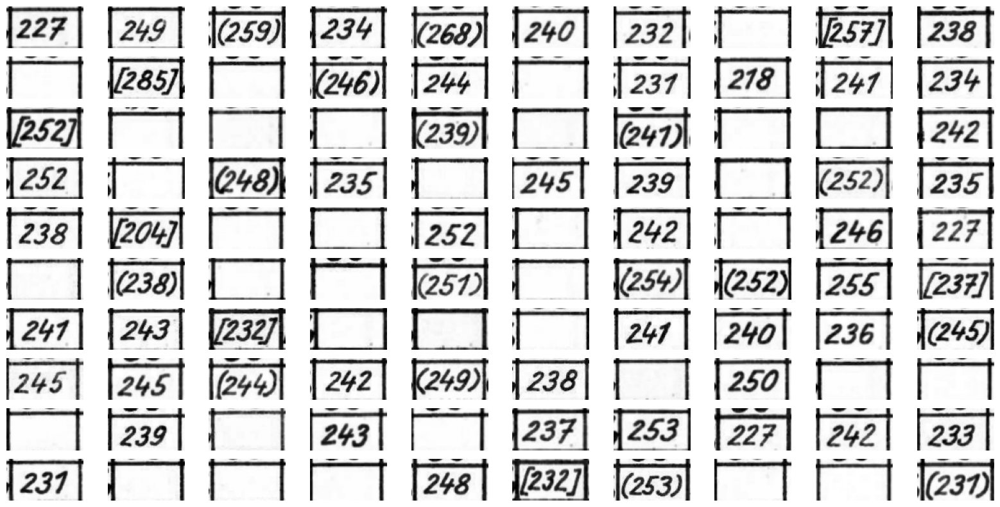

In [51]:
oats_ripe_for_harvesting_images = show_selection(tables,
                                                 species_phases_dicts['oats_ripe_for_harvesting'],
                                                 offset = 7,
                                                 figsize=(20, 10),
                                                 rotate = False,
                                                 selem_size = SELEM_SIZE,
                                                 selection_size = 100,
                                                 subplot_size = (10, 10),
                                                 table_rows = table_rows,
                                                 table_cols = table_cols,
                                                 use_dilation = True)

### Get ready to read the snippets

First we need to load the model

In [52]:
model_id = "Qwen/Qwen2.5-VL-32B-Instruct"

In [53]:
model, processor = get_model_and_processor(model_id,
                                           max_pixels = 4*1024,
                                           device='cuda')

Loading checkpoint shards:   0%|          | 0/18 [00:00<?, ?it/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


Then define system prompts for the different data types...

In [54]:
SYSTEM_MESSAGE_PHENOLOGY = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.

The texts can consist of the following:
1) A number only, the number can have from 1 to 3 digits.
2) A number surrounded by ordinary parenthesis.
3) A number surrounded by sqaure brackets.
5) The letter 'e'
6) The letter 'k'
7) The letter 's'
6) The percent sign '%'
7) No text at all.

Instructions:

**General Rules**:
    - Return the text as a string.
    - If the snippet contains no text, return "unknown".
    - In order to separate the digit 1 from the digit 7, know that the digit 7 always will have a horizontal stroke appearing in the middle of the digit.
      If there is no such horizontal stroke, the digit is a 1 even if it might look like a 7.
    - Beware that the text will often be surrounded by a black border, do not confuse this with the text.  In particular
      it is easy to confuse the digit 1 with parts of the border.
    - Ignore anything OUTSIDE the border.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [55]:
SYSTEM_MESSAGE_NUMBER = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed by
the text 'Nr:' followed by a number.  The number can have 1 to 3 digits.  At the end of the number, there
might be a letter a, b, c, d or e.

Examples:
'Nr: 2' 
or
'Nr: 123'
or
'Nr: 10a'
or
'Nr: 10b'
or
'Nr: 110d'

**General Rules**:
    - Return the entire text as a string.
    - Pay very close attention to the possibility of a letter a or b at the end of the number.  It is
      very important that you do not mistake a letter for a digit.  In particular it is easy to confuse
      the letter 'b' with the digit '6'.  Do not do that.
    - Do NOT remove the 'Nr:' part of the text.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [56]:
SYSTEM_MESSAGE_POSITION = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
a position and some more information.

The position part appears first, it will be on this format:

70'1°N, 23'10°E

Notice that this is NOT the standard format for latitude and longitude.  The standard format is:

70°1'N, 23°10'E

but this is not the format used in the table.

Be very carful not to miss the "'" symbol as it can appear small in the scanned text.

The position must be valid for mainland Norway so the minimal latitude is 57 and the maximal latitude is 71.
The minimal longitude is 4 and the maximal longitude is 31.

**General Rules**:
    - Return the text as a string.
    - Do NOT use more than TWO digits for the degrees.  If there are more than two digits, use the first two
      as degrees and the rest as minutes.
    - Pay VERY CLOSE attention to the degrees mark "'", it can be very small and look more like a dot than a "'".
    - Return the position in the standard format using degrees and  minutes represented as ° and '.
    - A typical position will look like this: 70°1'N, 23°1'E or 70°1'N, 5°1'E.
    - Return the full string, not only the position.  The full string will be something like:
      69'8⁰N, 6'2⁰E, H=32m, K=20km

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [57]:
SYSTEM_MESSAGE_HASL = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
a position and some more information.

The position part appears first, it will be on this format:

70'1°N, 23'10°E

Notice that this is NOT the standard format for latitude and longitude.  The standard format is:

70°1'N, 23°10'E

but this is not the format used in the table.

Be very carful not to miss the "'" symbol as it can appear small in the scanned text.

The position must be valid for mainland Norway so the minimal latitude is 57 and the maximal latitude is 71.
The minimal longitude is 4 and the maximal longitude is 31.

**General Rules**:
    - Return the text as a string.
    - Do NOT use more than TWO digits for the degrees.  If there are more than two digits, use the first two
      as degrees and the rest as minutes.
    - Pay VERY CLOSE attention to the degrees mark "'", it can be very small and look more like a dot than a "'".
    - Return the position in the standard format using degrees and  minutes represented as ° and '.
    - A typical position will look like this: 70°1'N, 23°1'E or 70°1'N, 5°1'E.
    - Return the full string, not only the position.  The full string will be something like:
      69'8⁰N, 6'2⁰E, H=32m, K=20km

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [58]:
SYSTEM_MESSAGE_DS = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
a position and some more information.

The position part appears first, it will be on this format:

70'1°N, 23'10°E

Notice that this is NOT the standard format for latitude and longitude.  The standard format is:

70°1'N, 23°10'E

but this is not the format used in the table.

Be very carful not to miss the "'" symbol as it can appear small in the scanned text.

The position must be valid for mainland Norway so the minimal latitude is 57 and the maximal latitude is 71.
The minimal longitude is 4 and the maximal longitude is 31.

**General Rules**:
    - Return the text as a string.
    - Do NOT use more than TWO digits for the degrees.  If there are more than two digits, use the first two
      as degrees and the rest as minutes.
    - Pay VERY CLOSE attention to the degrees mark "'", it can be very small and look more like a dot than a "'".
    - Return the position in the standard format using degrees and  minutes represented as ° and '.
    - A typical position will look like this: 70°1'N, 23°1'E or 70°1'N, 5°1'E.
    - Return the full string, not only the position.  The full string will be something like:
      69'8⁰N, 6'2⁰E, H=32m, K=20km

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [59]:
SYSTEM_MESSAGE_LOCATION = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
the word 'Ort:' followed by a location.

**General Rules**:
    - Return the text as a string.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

In [60]:
SYSTEM_MESSAGE_COUNTY = """
Below is an instruction that describes a task, write a response that appropriately completes the request.

You are an expert at reading handwritten table entries.  I will give you a snippet of a table and you will
read the text in the snippet and return the text as a string.  The text in the snippet will be composed of
the word 'Fylke:' followed by a county.

**General Rules**:
    - Return the text as a string.

Respond **ONLY** with the string. Do not provide explanations or reasoning.
"""

Test the model on some images

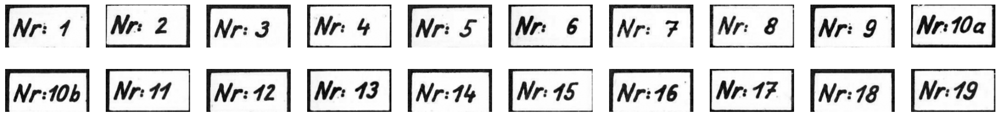

In [61]:
fig, axs = plt.subplots(2, 10, figsize=(25, 3))
for i in range(2):
    for j in range(10):
        axs[i, j].imshow(nr_images[i*10+j], cmap='gray', vmin=0, vmax=1)
        axs[i, j].axis('off')
plt.show()

In [62]:
N = 0

In [63]:
nr_images[N].shape

(92, 180)

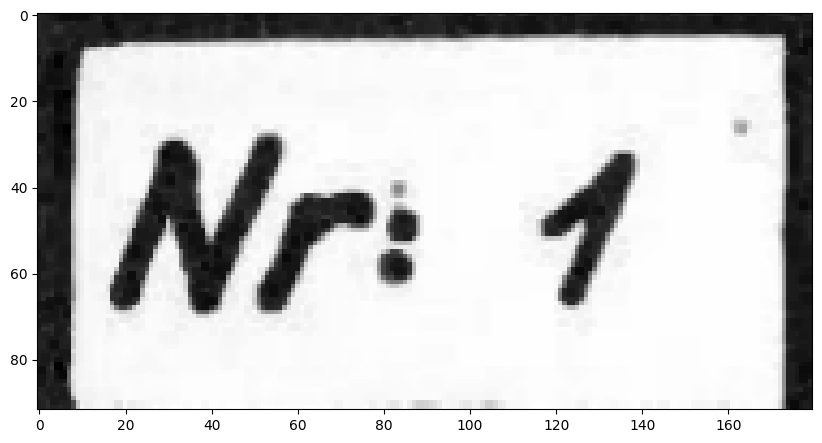

In [64]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
axs.imshow(nr_images[N], cmap='gray', vmin=0, vmax=1)
plt.show()

In [66]:
res, text = generate_description(nr_images[N], model, processor, SYSTEM_MESSAGE_NUMBER, scale_factor=INFERENCE_SCALE_FACTOR)

In [67]:
res

'Nr: 1'

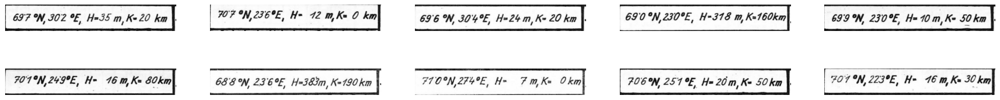

In [68]:
fig, axs = plt.subplots(2, 5, figsize=(25, 3))
for i in range(2):
    for j in range(5):
        axs[i, j].imshow(position_images[i*5+j], cmap='gray', vmin=0, vmax=1)
        axs[i, j].axis('off')
plt.show()

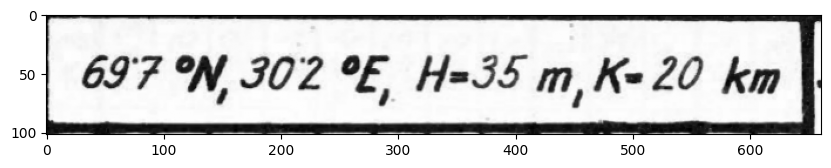

In [69]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
axs.imshow(position_images[N], cmap='gray', vmin=0, vmax=1)
plt.show()

In [70]:
res, text = generate_description(position_images[N], model, processor, SYSTEM_MESSAGE_POSITION, scale_factor=INFERENCE_SCALE_FACTOR)

In [71]:
res

"69°7'N, 30°2'E, H=35 m, K=20 km"

In [72]:
parse_coordinates(res)

(69.7, 30.2)

### Now get all the cells

Start by listing all the observations that will make up the table

In [73]:
observations = list(species_phases_dicts.keys())

In [74]:
count = 1
for obs in species_list:
    # Start with the Norwegian name
    name = obs['norwegian_name']
    
    # Build optional extras
    extras = []
    if obs.get('english_name'):
        extras.append(f"English name: {obs['english_name']}")
    if obs.get('latin_name'):
        extras.append(f"Latin name: {obs['latin_name'].capitalize()}")

    if extras:
        name += " (" + ", ".join(extras) + ")"

    # Print with or without phases
    if obs.get('phases'):
        for phase in obs['phases']:
            print(f"{count}. {name} ---> {phase}")
            count += 1
    else:
        print(f"{count}. {name}")
        count += 1

1. Nummer (English name: Number)
2. Lokasjon (English name: Location)
3. Fylke (English name: County)
4. Posisjon (English name: Position)
5. HOH (English name: HASL)
6. DH (English name: DS)
7. Hestehov (English name: Coltsfoot, Latin name: Tussilago farfara) ---> flowering
8. Hestehov (English name: Coltsfoot, Latin name: Tussilago farfara) ---> fruit
9. Hestehov (English name: Coltsfoot, Latin name: Tussilago farfara) ---> timespan
10. Blåveis (English name: Liverleaf, Latin name: Hepatica nobilis) ---> flowering
11. Blåveis (English name: Liverleaf, Latin name: Hepatica nobilis) ---> fruit
12. Blåveis (English name: Liverleaf, Latin name: Hepatica nobilis) ---> timespan
13. Hvitveis (English name: Wood anemone, Latin name: Anemone nemorosa) ---> flowering
14. Hvitveis (English name: Wood anemone, Latin name: Anemone nemorosa) ---> fruit
15. Hvitveis (English name: Wood anemone, Latin name: Anemone nemorosa) ---> timespan
16. Rødsildre (English name: Purple saxifrage, Latin name: Sa

Then make a data frame to hold everything

In [75]:
columns = []

for observation in observations:
    columns.append(f'{observation}')
    columns.append(f'{observation}_image')

phenology_df = pd.DataFrame(columns=columns)

Loop an fill in

In [76]:
idx = 0
tmp_tables = tables
total_tables = len(tmp_tables)
total_observations = len(observations)
obs_counter = 1  # Flat counter across all table-observation pairs

for table_idx, table in enumerate(tqdm(tmp_tables, desc='Processing tables', total=total_tables)):
    
    for obs_idx, observation in enumerate(observations):
        # Build and print status line with fixed width
        status_line = f"  └─ Processing observation: '{observation}' ({obs_counter} of {total_observations})"
        print(status_line.ljust(160), end='\r')  # Padding to prevent leftover characters

        # Extract images
        if observation in ['position', 'hasl', 'ds']:
            images = show_selection([table],
                                    species_phases_dicts[observation],
                                    offset=7,
                                    rotate=True,
                                    selem_size=SELEM_SIZE,
                                    selection_size=None,
                                    table_rows = table_rows,
                                    table_cols = table_cols,
                                    show_images=False,
                                    use_dilation = True)
        else:
            images = show_selection([table],
                                    species_phases_dicts[observation],
                                    offset=7,
                                    rotate=False,
                                    selem_size=SELEM_SIZE,
                                    selection_size=None,
                                    table_rows = table_rows,
                                    table_cols = table_cols,
                                    show_images=False,
                                    use_dilation = True)

        for image in images:
            english_name = species_phases_dicts[observation]['english_name']

            if english_name == 'Number':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_NUMBER, scale_factor=INFERENCE_SCALE_FACTOR)
                phenology_df.loc[table_idx, 'number'] = re.sub(r'^Nr:\s*', '', res)
                phenology_df.loc[table_idx, 'number_image'] = img_to_bytes(image)
            elif english_name == 'Location':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_LOCATION, scale_factor=INFERENCE_SCALE_FACTOR)
                phenology_df.loc[table_idx, 'location'] = re.sub(r'^Ort:\s*', '', res)
                phenology_df.loc[table_idx, 'location_image'] = img_to_bytes(image)
            elif english_name == 'County':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_COUNTY, scale_factor=INFERENCE_SCALE_FACTOR)
                phenology_df.loc[table_idx, 'county'] = re.sub(r'^Fylke:\s*', '', res)
                phenology_df.loc[table_idx, 'county_image'] = img_to_bytes(image)
            elif english_name == 'Position':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_POSITION, scale_factor=INFERENCE_SCALE_FACTOR)
                lat, lon = parse_coordinates(res)
                phenology_df.loc[table_idx, 'position'] = f'{lat:.4f}, {lon:.4f}'
                phenology_df.loc[table_idx, 'position_image'] = img_to_bytes(image)
            elif english_name == 'HASL':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_HASL, scale_factor=INFERENCE_SCALE_FACTOR)
                match = re.match(r'.*H\s*=\s*\({0,1}(\d{1,})\){0,1}\s*m.*', res)
                phenology_df.loc[table_idx, 'hasl'] = match.group(1) if match else None
            elif english_name == 'DS':
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_DS, scale_factor=INFERENCE_SCALE_FACTOR)
                match = re.match(r'.*K\s*=\s*(\d{1,4})', res)
                phenology_df.loc[table_idx, 'ds'] = match.group(1) if match else None
            else:
                res, text = generate_description(image, model, processor, SYSTEM_MESSAGE_PHENOLOGY, scale_factor=INFERENCE_SCALE_FACTOR)
                phenology_df.loc[table_idx, f'{observation}'] = res
                phenology_df.loc[table_idx, f'{observation}_image'] = img_to_bytes(image)

        obs_counter += 1  # Increment after every observation per table

    obs_counter = 0

Processing tables:   0%|          | 0/278 [00:00<?, ?it/s]

Exception ignored in: <function ResourceTracker.__del__ at 0x788aa1d767a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x70d77239e7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in 

Exception ignored in: <function ResourceTracker.__del__ at 0x7f622bf7e7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes


Exception ignored in: <function ResourceTracker.__del__ at 0x742e7298a7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x7f823f38a7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in 

Exception ignored in: <function ResourceTracker.__del__ at 0x73502118a7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes


Exception ignored in: <function ResourceTracker.__del__ at 0x7b12d7d827a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x73890478e7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in 

Exception ignored in: <function ResourceTracker.__del__ at 0x78a53d9867a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x7c0ab79767a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in 

Exception ignored in: <function ResourceTracker.__del__ at 0x7d588c7767a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x7f24fe38a7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in 

Exception ignored in: <function ResourceTracker.__del__ at 0x724e1598e7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes


Exception ignored in: <function ResourceTracker.__del__ at 0x72b65758e7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x74c349d767a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in 

Exception ignored in: <function ResourceTracker.__del__ at 0x7f37cfd867a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes


Exception ignored in: <function ResourceTracker.__del__ at 0x717fd7d767a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x7a4a1df8a7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in 

Exception ignored in: <function ResourceTracker.__del__ at 0x74f56dd827a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes
Exception ignored in: <function ResourceTracker.__del__ at 0x7ba0dfd7e7a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in 

Exception ignored in: <function ResourceTracker.__del__ at 0x7cdbb67867a0>
Traceback (most recent call last):
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 82, in __del__
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 91, in _stop
  File "/home/lars/.local/share/uv/python/cpython-3.13.3-linux-x86_64-gnu/lib/python3.13/multiprocessing/resource_tracker.py", line 116, in _stop_locked
ChildProcessError: [Errno 10] No child processes


Finally save two versions of the data frame to disk, one without the images, one with the images.

In [77]:
phenology_df_no_images = phenology_df[[col for col in phenology_df.columns if '_image' not in col]]
phenology_df_no_images.to_pickle('../data/processed/phenology_df_no_images.pkl')

In [78]:
phenology_df.to_pickle('../data/processed/phenology_df.pkl')

In [79]:
phenology_df_no_images.head(10)

,number,location,county,position,hasl,ds,coltsfoot_flowering,coltsfoot_fruit,coltsfoot_timespan,liverleaf_flowering,...,winter_rye_ripe_for_harvesting,percentage_of_unripe_winter_rye,oats_ripe_for_harvesting,oats_maturing_time,percentage_of_unripe_barley,barley_ripe_for_harvesting,barley_maturing_time,wheat_ripe_for_harvesting,wheat_maturing_time,percentage_of_unripe_wheat
0,1,"Elvenes, Sørvaranger",F16,"69.7000, 30.2000",35,20,137,173,36,unknown,...,unknown,%,[260],[100],7%,[262],[100],unknown,unknown,%
1,2,Hammerfest,F,"70.7000, 23.6000",12,0,unknown,unknown,unknown,130,...,unknown,%,unknown,unknown,%,unknown,unknown,unknown,unknown,%
2,3,Jarfjordbotn,F16,"69.6000, 30.4000",24,20,unknown,unknown,unknown,unknown,...,unknown,%,unknown,unknown,%,unknown,unknown,unknown,unknown,%
3,4,Kautokeino,F1,"69.0000, 23.0000",318,160,unknown,unknown,unknown,unknown,...,unknown,%,(232),69,(50)%,[230],unknown,unknown,unknown,%
4,5,Kåfjord,F2,"69.9000, 23.0000",10,50,(122),[176],[54],unknown,...,unknown,%,unknown,unknown,%,unknown,unknown,unknown,unknown,%
5,6,Lakselv,F8,"70.1000, 24.9000",16,80,[158],[208],[50],unknown,...,unknown,%,[226],[75],79%,(236),(82),unknown,unknown,%
6,7,Siccajavre,F1,"68.8000, 23.6000",383,190,unknown,unknown,unknown,174,...,unknown,%,unknown,unknown,%,unknown,unknown,unknown,unknown,%
7,8,Skjøtningberg,F11,"71.0000, 27.4000",7,0,unknown,unknown,unknown,[136],...,unknown,%,unknown,unknown,%,unknown,unknown,unknown,unknown,%
8,9,"Smørfjord, Porsanger",F8,"70.6000, 25.7000",20,50,unknown,unknown,unknown,unknown,...,unknown,%,unknown,unknown,%,e,unknown,e,unknown,%
9,10a,"Sopnes, Talvik.",F3,"70.1000, 22.3000",16,30,122,unknown,unknown,unknown,...,unknown,%,(238),(73),100%,244,79,unknown,unknown,%


In [80]:
phenology_df[[col for col in phenology_df.columns if '_image' not in col]]

,number,location,county,position,hasl,ds,coltsfoot_flowering,coltsfoot_fruit,coltsfoot_timespan,liverleaf_flowering,...,winter_rye_ripe_for_harvesting,percentage_of_unripe_winter_rye,oats_ripe_for_harvesting,oats_maturing_time,percentage_of_unripe_barley,barley_ripe_for_harvesting,barley_maturing_time,wheat_ripe_for_harvesting,wheat_maturing_time,percentage_of_unripe_wheat
0,1,"Elvenes, Sørvaranger",F16,"69.7000, 30.2000",35,20,137,173,36,unknown,...,unknown,%,[260],[100],7%,[262],[100],unknown,unknown,%
1,2,Hammerfest,F,"70.7000, 23.6000",12,0,unknown,unknown,unknown,130,...,unknown,%,unknown,unknown,%,unknown,unknown,unknown,unknown,%
2,3,Jarfjordbotn,F16,"69.6000, 30.4000",24,20,unknown,unknown,unknown,unknown,...,unknown,%,unknown,unknown,%,unknown,unknown,unknown,unknown,%
3,4,Kautokeino,F1,"69.0000, 23.0000",318,160,unknown,unknown,unknown,unknown,...,unknown,%,(232),69,(50)%,[230],unknown,unknown,unknown,%
4,5,Kåfjord,F2,"69.9000, 23.0000",10,50,(122),[176],[54],unknown,...,unknown,%,unknown,unknown,%,unknown,unknown,unknown,unknown,%
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
273,256,Sarpsborg,Ø,"59.3000, 11.0000",50,10,86,[141],[55],96,...,226,%,240,105,%,240,100,237,105,%
274,257,Skjeberg,Ø 13,"59.2000, 11.1000",30,0,81,unknown,unknown,93,...,unknown,%,[234],unknown,%,[231],unknown,unknown,unknown,%
275,258,"Slevik, Onsøy",Ø21,"59.2000, 10.8000",35,0,82,unknown,unknown,84,...,(234),%,250,118,%,unknown,unknown,unknown,unknown,%
276,259,Spydeberg,Ø23,"59.5000, 11.0000",115,20,86,[111],[25],98,...,225,%,241,107,%,236,93,241,110,%


Make whatever consistaency tests you want, for instance HASL should probably not be much more than 1000m

In [81]:
np.max([int(v) for v in phenology_df['hasl'].values if v is not None])

np.int64(1000)